In [5]:
#%%capture
# !pip install palettable
# !pip install contextily
# !pip install osmnx
# !pip install pysal

In [6]:
import os
os.environ['USE_PYGEOS'] = '0'
import helpers as hs
from importlib import reload

# Descriptive data for selected neighbourhoods

## Choice of categories 

In order to analyse the city composition around POIs, we define aggregated categories of POIs, based on \textit{OpenStreetMap} build in categories :

- **Restaurants**: all types of restaurants inclunding cafes, bars, fast-foods, pubs, ice-cream shops.
- **Culture and art** : shops and amenities related to literature, music, cinema, plastic arts, performances, video games, games.
- **Education**: primary schools, middle schools, high schools, colleges, universities. 
- **Food shops** : including supermarkets as well as specialist food shops (e.g. backeries, butchers, dairy shops, seafood shops, wine shops...).
- **Fashion and beauty** : all shops related to clothes, fashion accessories (e.g. jewelleries, watches), beauty care (e.g. cosmetics, hairdresser, massage, hair removal, perfumery).
- **Supply shops** : everyday life shops apart from food shops (e.g. insurance, sport shops, furniture shops, household appliance shops ...)

In [9]:
from helpers.scrapping import categories_tags
for x in categories_tags : 
    print('category : ', x)
    print('corresponding tags : ',categories_tags[x], '\n')

category :  restaurant
corresponding tags :  ['restaurant', 'cafe', 'bar', 'ice_cream', 'fast_food', 'pub', 'food_court', 'biergarten'] 

category :  culture and art
corresponding tags :  ['library', 'toy_library', 'music_school', 'arts_centre', 'cinema', 'conference_centre', 'events_venue', 'planetarium', 'public_bookcase', 'studio', 'theatre', 'art', 'camera', 'collector', 'craft', 'frame', 'games', 'model', 'musique', 'musical_instrument', 'photo', 'trophy', 'video', 'video_games', 'anime', 'books', 'ticket', 'antiques'] 

category :  education
corresponding tags :  ['college', 'kindergarten', 'school', 'university'] 

category :  food_shops
corresponding tags :  ['alcohol', 'bakery', 'butcher', 'cheese', 'beverages', 'brewing_supplies', 'chocolate', 'coffee', 'confectionery', 'convenience', 'deli', 'dairy', 'farm', 'frozen_food', 'greengrocer', 'ice_cream', 'pasta', 'pastry', 'seafood', 'spices', 'tea', 'wine', 'water', 'supermarket'] 

category :  fashion_beauty
corresponding tags

## First results

In [13]:
%%capture
places = ["Gare du Nord", "Porte de la Chapelle", "Opéra Garnier", "Sacré Coeur", "Place de la Bastille", 
          "Arc de triomphe", "Olympiades", "Quartier de Javel", "Eglise du Saint-Esprit", "Place des Vosges"]
fig = hs.compare_places(places)

TypeError: Nominatim could not geocode query 'Gare du Nord, Paris, Ile-de-France, France' to a geometry of type (Multi)Polygon

/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [10]:
fig.show()

NameError: name 'fig' is not defined

/Users/yubocai/Desktop/Ecole Polytechnique/Internship/CREST/BATO_extension/helpers/scrapping.py:192: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  gdf_pois = ox.geometries_from_place(place, tags, buffer_dist=1000)
/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/osmnx/geometries.py:127: UserWarning: The buffer_dist argument as been deprecated and will be removed in a future release. Buffer your query area directly, if desired.
  return features.features_from_place(query, tags, which_result, buffer_dist)
/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/osmnx/features.py:268: UserWarning: The buffer_dist argument as been deprecated and will be removed in a future release. Buffer your results directly, if desired.
  gdf_place = geocoder.geocode_to_g

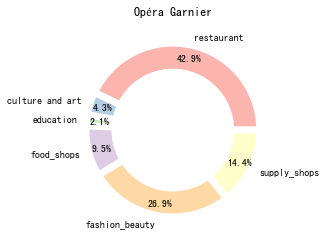

In [11]:
hs.composition_chart('Opéra Garnier')

c:\Users\leopo\OneDrive - GENES\BATO-MOUCHE-Stat-App\helpers\scrapping.py:192: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




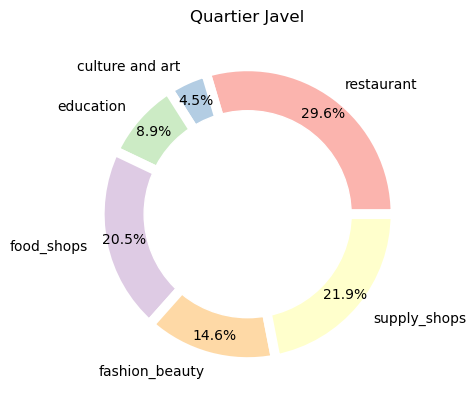

In [ ]:
hs.composition_chart('Quartier Javel')

# Création de la base  de données

## Création des données aggrégées sur la grille INSPIRE 200X200m
On part des données OSM cad une liste de points avec coordonnées et infos et on veut obtenir une liste des carrés INSPIRE avec le total des catégories par carré.

In [ ]:
filosofi_file = "data/Filosofi2015_carreaux_200m_paris.gpkg"
pgdf = hs.get_POI_cat_on_INSPIRE_grid(filosofi_file)

/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/Users/yubocai/Desktop/Ecole Polytechnique/Internship/CREST/BATO/helpers/scrapping.py:189: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  gdf_pois = ox.geometries_from_place(place, tags, buffer_dist=1000)
/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/osmnx/geometries.py:127: UserWarning: The buffer_dist argument as been deprecated and will be removed in a future release. Buffer your quer

In [ ]:
hs.folium_grid_cat_plot(pgdf,"restaurant")

/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Adding variable

In [ ]:
pgdf['Log'] = pgdf['Log_inc'] + pgdf['Log_av45'] + pgdf['Log_45_70'] + pgdf['Log_70_90'] + pgdf['Log_ap90'] # nombre total de logement

/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Calcul des indices d'accessibilité

### two-step floating catchment area method (2SFCA)

#### Weight calcul

In [ ]:
# weights can be a bit long so it's preferable to create a variable
idCol = "IdINSPIRE"
weights_by_id = hs.calculate_distanceband_weights(pgdf,idCol=idCol) 
# note it sets the idCol as index for the rest of the program to work weights_by_id and gdf needs to have the same index

/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/scipy/sparse/_data.py:117: RuntimeWarning: divide by zero encountered in reciprocal
  return self._with_data(data ** n)


In [ ]:
weights_by_id

/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,CRS3035RES200mN2893400E3763200,CRS3035RES200mN2890000E3762200,CRS3035RES200mN2893400E3762400,CRS3035RES200mN2891800E3763600,CRS3035RES200mN2890800E3763200,CRS3035RES200mN2885800E3760600,CRS3035RES200mN2888400E3761400,CRS3035RES200mN2891800E3763800,CRS3035RES200mN2890000E3762400,CRS3035RES200mN2893400E3762800,...,CRS3035RES200mN2889000E3762400,CRS3035RES200mN2890000E3764000,CRS3035RES200mN2893200E3756800,CRS3035RES200mN2893200E3758800,CRS3035RES200mN2891400E3762200,CRS3035RES200mN2887400E3764400,CRS3035RES200mN2891400E3762000,CRS3035RES200mN2893000E3758400,CRS3035RES200mN2893200E3758200,CRS3035RES200mN2893200E3756600
CRS3035RES200mN2893400E3763200,1.000000,0.0,0.125287,0.0,0.0,0.0,0.0,0.00000,0.000000,0.250574,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0
CRS3035RES200mN2890000E3762200,0.000000,1.0,0.000000,0.0,0.0,0.0,0.0,0.00000,0.501148,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0
CRS3035RES200mN2893400E3762400,0.125287,0.0,1.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.250573,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0
CRS3035RES200mN2891800E3763600,0.000000,0.0,0.000000,1.0,0.0,0.0,0.0,0.50115,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0
CRS3035RES200mN2890800E3763200,0.000000,0.0,0.000000,0.0,1.0,0.0,0.0,0.00000,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CRS3035RES200mN2887400E3764400,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.000000,1.0,0.0,0.000000,0.000000,0.0
CRS3035RES200mN2891400E3762000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.501147,0.0,1.0,0.000000,0.000000,0.0
CRS3035RES200mN2893000E3758400,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.000000,...,0.0,0.0,0.000000,0.223820,0.000000,0.0,0.0,1.000000,0.354568,0.0
CRS3035RES200mN2893200E3758200,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.000000,...,0.0,0.0,0.000000,0.167046,0.000000,0.0,0.0,0.354568,1.000000,0.0


##### Vérifions la cohérence

In [ ]:
import folium

In [ ]:
weights_by_id[pgdf.index[1]].values

/Users/yubocai/anaconda3/envs/mlp/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


array([0., 1., 0., ..., 0., 0., 0.])

In [ ]:
m=folium.Map((48.8534100,2.3488000), zoom_start=12.1)
m = pgdf[["geometry"]].assign(weight_0 = weights_by_id[pgdf.index[1]].values).explore(
    m = m,
    column = 'weight_0',
    tooltip = 'IdINSPIRE',
    tiles= "OpenStreetMap",
    popup = True,
    cmap = 'Set1',
    style_kwds = dict(color = "black",fillOpacity=0.4),
)
m

In [ ]:
m=folium.Map((48.8634100,2.3588000), zoom_start=13.5)
m = pgdf[["geometry"]].assign(weight_0 = weights_by_id[pgdf.index[1]].values).explore(
    m = m,
    column = 'weight_0',
    tooltip = 'weight_0',
    tiles= "OpenStreetMap",
    popup = True,
    cmap = 'Set1',
    style_kwds = dict(color = "black",fillOpacity=0.4),
)
m

#### Calculate accessibility

In [ ]:
interestVar = ['Log','Log_soc','restaurant',
       'culture and art', 'education', 'food_shops', 'fashion_beauty',
       'supply_shops']
accessibility_measures = hs.calculate_2SFCA_accessibility(pgdf,interestVar,weights_by_id)

In [ ]:
for var in interestVar:
    pgdf[var+"_access"] = accessibility_measures[var]

In [ ]:
hs.folium_grid_cat_plot(pgdf,"Log_soc_access")

### Aggregated accesibility (calcul grossier): 

On somme tout les calculs d'accessibilité mais le problème est que nous ne disposons pas de poids pour chaque aménité qui est calculé par la fréquence des personnes allant dans chaque lieu. Une idée simple serait de faire le rapport pour chaque aménité entre le nombre d'aménités p sur le nombre total d'aménités et donner un poids opposé à sa fréquence dans le calcul final : 
 $$ w_{p} = \frac{N_{p}}{N} $$
 
 L'idée est que moins il y a d'aménités, plus l'aménité en question est importante : il y a qu'une école alors qu'il y a 20 restaurants. Mais cela laisse de nombreux biais en surfavorisant les lieux de culture et les lieux d'éducation. 
 
 On obtiendrait ainsi pour la cellule i, le 2SFCA aggrégé : 
 $ CS_{i} = \sum_{p=1}^{P} (1 -w_{p}) \times X_{i,p} $ avec $ X_{i,p} = \frac{A_{i,p} - \min {A_{i,p}}}{\max{A_{p}} - \min{A_{p}}} $, la normalisation min-max de l'accessibilité de la cellule i à l'aménité p $A_{i,p}$. 
 
 On présentera ici un estimateur sans les poids et un autre avec. 


 
 

In [ ]:
#weight calcul 
interestVar2 = ['restaurant',
       'culture and art', 'education', 'food_shops', 'fashion_beauty',
       'supply_shops']
for var in interestVar2:
        pgdf[str("weight_" + var)] = pgdf[var].sum()/(pgdf[interestVar2].sum(axis = 1).sum())

In [ ]:
1 - pgdf[[str("weight_" + var) for var in interestVar2]]

,weight_restaurant,weight_culture and art,weight_education,weight_food_shops,weight_fashion_beauty,weight_supply_shops
IdINSPIRE,,,,,,
CRS3035RES200mN2893400E3763200,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543
CRS3035RES200mN2890000E3762200,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543
CRS3035RES200mN2893400E3762400,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543
CRS3035RES200mN2891800E3763600,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543
CRS3035RES200mN2890800E3763200,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543
...,...,...,...,...,...,...
CRS3035RES200mN2887400E3764400,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543
CRS3035RES200mN2891400E3762000,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543
CRS3035RES200mN2893000E3758400,0.633005,0.94935,0.964015,0.842049,0.803037,0.808543


In [ ]:
weight_table = 1 - pgdf[[str("weight_" + var) for var in interestVar2]]
print(weight_table.iloc[[0]].to_latex())

\begin{tabular}{lrrrrrr}
\toprule
{} &  weight\_restaurant &  weight\_culture and art &  weight\_education &  weight\_food\_shops &  weight\_fashion\_beauty &  weight\_supply\_shops \\
IdINSPIRE                      &                    &                         &                   &                    &                        &                      \\
\midrule
CRS3035RES200mN2893400E3763200 &           0.633005 &                 0.94935 &          0.964015 &           0.842049 &               0.803037 &             0.808543 \\
\bottomrule
\end{tabular}



C:\Users\leopo\AppData\Local\Temp\ipykernel_1972\1019599727.py:2: FutureWarning:

In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.



**Commentaire :** On remarque le poids de l'éducation et le poids de la culture et des arts sont beaucoup plus forts que celui des restaurants.

$(1 -w_{p}) \times X_{i,p} $ avec $ X_{i,p} = \frac{A_{i,p} - \min {A_{i,p}}}{\max{A_{p}} - \min{A_{p}}}$

In [ ]:
for var in interestVar2 : 
    pgdf[str(var + "_access" + "_norm*weight")] = (pgdf[str(var + "_access")].apply(lambda x : (x - pgdf[str(var + "_access")].min())/(pgdf[str(var + "_access")].max() - pgdf[str(var + "_access")].min())))*(1 - pgdf[str("weight_" + var)])

In [ ]:
for var in interestVar2 : 
    pgdf[str(var + "_access" + "without_norm*weight")] = (pgdf[str(var + "_access")].apply(lambda x : (x - pgdf[str(var + "_access")].min())/(pgdf[str(var + "_access")].max() - 
                                                                                                                                       pgdf[str(var + "_access")].min())))

In [ ]:
pgdf["CS_aggregated"] = pgdf[[i + "_access_norm*weight" for i in interestVar2]].sum(axis = 1) 

In [ ]:
pgdf["CS_aggregated_without_weight"] = pgdf[[i + "_accesswithout_norm*weight" for i in interestVar2]].sum(axis = 1) 

**Without Weight**

In [ ]:
hs.folium_grid_cat_plot(pgdf,"CS_aggregated_without_weight")

**With weights**

In [ ]:
hs.folium_grid_cat_plot(pgdf,"CS_aggregated")

**Commentaire :** On remarque dans les deux cas un gradient en cercle concentrique dans l'accès aux aménités aggrégé partant de trois pôles principaux : le quartier Opéra, les Halles et le quartier Latin. Confirmant ainsi les statistiques descriptives sur le quartier de l'Opéra. Pour le Quartier Latin, cela s'explique par la forte présence à la fois de musées, d'établissements universitaire/secondaires. Le quartier des Halles s'explique par le centre commercial. On remarque que lorsqu'on rajoute des poids certains carrés affiche un score d'accès plus important comme à Passy dans le XVIème arrondissment. Cela s'explique par les caractéristiques de cet arrondissement : majoritairement composé de personnes agées favorisées, il présente un nombre important d'établissements scolaires dans lequel sont scolarisés de nombreux enfants ne venant pas du quartier  (Saint-Jean de Passy, Franklin, Janson, de la Tour,etc... au total 13 lycées) 

# Analyses

## Régression

"L’autocorrélation spatiale a deux sources principales :
- elle peut provenir du fait que les données sont affectées par des processus qui relient des lieux différents et qui sont à l’origine d’une organisation spatiale particulière des activités. En effet, les processus d’interactions sont source d’autocorrélation spatiale lorsque les événements ou les circonstances en un lieu donné affectent les conditions en d’autres lieux si ces derniers interagissent d’une manière ou d’une autre, par des mouvements de biens, de personnes, de capitaux, des externalités spatiales ou toutes les formes de comportements où un acteur économique réagit aux actions d’autres acteurs. Par exemple, la diffusion d’un phénomène (comme la diffusion technologique) à partir d’un ou de plusieurs lieux d’origine implique que l’intensité de la mesure de ce phénomène dépend de la distance à l’origine. Aux localisations proches les unes des autres, donc à des distances comparables de l’origine, seront donc associées des intensités similaires pour le phénomène étudié ;
- elle peut également provenir d’une mauvaise spécification du modèle, comme des variables omises spatialement autocorrélées, d’une forme fonctionnelle incorrecte ou d’erreurs de mesure (c’est en particulier le cas lorsque l’étendue spatiale du phénomène étudié ne coïncide pas avec les unités spatiales d’observation). Elle est alors considérée comme un outil de diagnostic et de détection d’une mauvaise spécification du modèle." 

(source : https://www.cairn.info/revue-economie-et-prevision-2002-4-page-139.htm)

### Spatial Weight 
Choix d'un poids continu au format Queen suivant l'indice de Moran (à vérifier). 



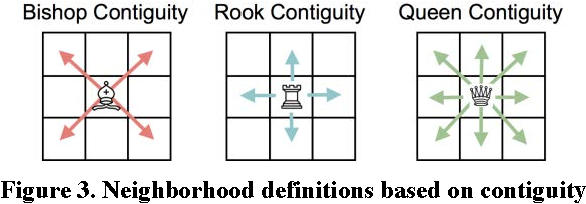

In [ ]:
from pysal.lib import weights
w_queen = weights.contiguity.Queen.from_dataframe(pgdf) # adjacent in all directions, including diagonal.
# Replace Queen by rook for only up/down/left/right adjancy
w_queen.transform = 'r'


('WARNING: ', 196, ' is an island (no neighbors)')
('WARNING: ', 231, ' is an island (no neighbors)')
('WARNING: ', 744, ' is an island (no neighbors)')
('WARNING: ', 780, ' is an island (no neighbors)')
('WARNING: ', 813, ' is an island (no neighbors)')
('WARNING: ', 823, ' is an island (no neighbors)')
('WARNING: ', 836, ' is an island (no neighbors)')
('WARNING: ', 841, ' is an island (no neighbors)')
('WARNING: ', 862, ' is an island (no neighbors)')
('WARNING: ', 1019, ' is an island (no neighbors)')
('WARNING: ', 1020, ' is an island (no neighbors)')
('WARNING: ', 1060, ' is an island (no neighbors)')
('WARNING: ', 1063, ' is an island (no neighbors)')
('WARNING: ', 1071, ' is an island (no neighbors)')
('WARNING: ', 1100, ' is an island (no neighbors)')
('WARNING: ', 1259, ' is an island (no neighbors)')
('WARNING: ', 1349, ' is an island (no neighbors)')
('WARNING: ', 1404, ' is an island (no neighbors)')
('WARNING: ', 1601, ' is an island (no neighbors)')
('WARNING: ', 1681, '

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\libpysal\weights\weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 33 disconnected components.
 There are 26 islands with ids: 196, 231, 744, 780, 813, 823, 836, 841, 862, 1019, 1020, 1060, 1063, 1071, 1100, 1259, 1349, 1404, 1601, 1681, 1754, 1766, 1769, 1779, 1781, 1788.



In [ ]:
from pysal.explore import esda
moran = esda.moran.Moran(pgdf["CS_aggregated"], w_queen)
print("Moran's I", moran.I,"Moran's simulated p-value",moran.p_sim)

Moran's I 0.9470201785648795 Moran's simulated p-value 0.001


c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\pointpats\geometry.py:22: DeprecationWarning:

Please use `ConvexHull` from the `scipy.spatial` namespace, the `scipy.spatial.qhull` namespace is deprecated.

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\pointpats\geometry.py:42: DeprecationWarning:

Please use `ConvexHull` from the `scipy.spatial` namespace, the `scipy.spatial.qhull` namespace is deprecated.

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\pointpats\geometry.py:85: DeprecationWarning:

Please use `ConvexHull` from the `scipy.spatial` namespace, the `scipy.spatial.qhull` namespace is deprecated.

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\pointpats\geometry.py:132: DeprecationWarning:

Please use `ConvexHull` from the `scipy.spatial` namespace, the `scipy.spatial.qhull` namespace is deprecated.

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\pointpats\geometry.py:174: DeprecationWarning:

Please use `ConvexHu

### Spatial Regression

L'autocorrélation spatiale désigne le fait que les variables ne sont pas réparties de manières idd dans l'espace. Il existe trois modèles principaux.

**Spatial error Model (SEM):** Ce modèle introduit un spatial lag dans le terme d'erreur. 

$$ Y_{i} = \alpha +  X_{i}\beta  + u_{i} $$
$$ u_{i}= \lambda u_{lag - i} + \epsilon_{i}$$

Avec $u_{lag - i} = \sum_{j}w_{i,j}u{j} $. Le paramètre $\lambda$ représente l'intensité de l'interdépendance entre les termes d'erreurs $u$.

**Spatial lag Model '(SAR):** Ce modèle introduit un spatial lag dans les variables dépendantes. 

$$ Y_{i} = \alpha +  \rho W Y_{lag - i}+ X\beta  + \epsilon_{i} $$

Regarde l'interdépendance spatiale avec les autres variables. On calcule l'endegenous lag en faisant une régression TWO-SLS avec pour instrument de l'endegenous lag, le spatial lag de toutes les variables explicatives. 

**SARMA:** Ce modèle dit SARMA combine les deux précèdentes approches. 

$$ Y = X\beta +  \rho W Y + \lambda u + \epsilon $$


### Préparation des données 

L'idée est de recréer les mêmes variables que l'article d'Utretch dans la mesure du possible : 
- % de foyer vivant en dessous du seuil minimum social (%_soc.minimum)
- % d'individus ayant plus de 65 ans (%_>_65)
- % d'individus ayant moins de 17 ans (%_<_17)
- % de logements construits avant 1945 (%_<_bat_45)
- % de logements construits après 1990 (%_>_bat_90)
- % de résidences collectives  (%_residences)
- La moyenne du revenu annuel par personne (mean_income)
- La densité par km^2 (density)

Nous ne disposons pas du pourcentage de personnes recevant les indémnités chômages ou les allocations RSA, ni du pourcentage de migrants, ni de la distance au transport le plus proche pour le moment. 

In [ ]:
pgdf["%_soc.minimum"] = (pgdf["Men_pauv"]/pgdf["Ind"])*100
pgdf["%_>_65"] = ((pgdf["Ind_65_79"] +pgdf["Ind_80p"])/pgdf["Ind"])*100
pgdf["%_<_17"] = ((pgdf["Ind_0_3"] +pgdf["Ind_4_5"] + pgdf["Ind_6_10"] + pgdf["Ind_11_17"])/pgdf["Ind"])*100
pgdf["%_<_bat_45"] = (pgdf["Log_av45"]/(pgdf["Log_av45"] +pgdf["Log_45_70"] + pgdf["Log_70_90"] + pgdf["Log_ap90"] + pgdf["Log_inc"]))*100
pgdf["%_>_bat_90"] = (pgdf["Log_ap90"]/(pgdf["Log_av45"] +pgdf["Log_45_70"] + pgdf["Log_70_90"] + pgdf["Log_ap90"] + pgdf["Log_inc"]))*100
pgdf["%_residences"] = (pgdf["Men_coll"]/(pgdf["Men_coll"] +pgdf["Men_mais"]))*100
pgdf["mean_income"] = pgdf["Ind_snv"]/pgdf["Ind"]
pgdf["density"] = pgdf["Ind"]/(0.0002)

In [ ]:
from pysal.lib import weights

### Lagrange Multiplier tests to choose regression 

In [ ]:
w_queen = weights.contiguity.Queen.from_dataframe(pgdf) # adjacent in all directions, including diagonal.
# Replace Queen by rook for only up/down/left/right adjancy

In [ ]:
w_queen.transform = 'r'

('WARNING: ', 196, ' is an island (no neighbors)')
('WARNING: ', 231, ' is an island (no neighbors)')
('WARNING: ', 744, ' is an island (no neighbors)')
('WARNING: ', 780, ' is an island (no neighbors)')
('WARNING: ', 813, ' is an island (no neighbors)')
('WARNING: ', 823, ' is an island (no neighbors)')
('WARNING: ', 836, ' is an island (no neighbors)')
('WARNING: ', 841, ' is an island (no neighbors)')
('WARNING: ', 862, ' is an island (no neighbors)')
('WARNING: ', 1019, ' is an island (no neighbors)')
('WARNING: ', 1020, ' is an island (no neighbors)')
('WARNING: ', 1060, ' is an island (no neighbors)')
('WARNING: ', 1063, ' is an island (no neighbors)')
('WARNING: ', 1071, ' is an island (no neighbors)')
('WARNING: ', 1100, ' is an island (no neighbors)')
('WARNING: ', 1259, ' is an island (no neighbors)')
('WARNING: ', 1349, ' is an island (no neighbors)')
('WARNING: ', 1404, ' is an island (no neighbors)')
('WARNING: ', 1601, ' is an island (no neighbors)')
('WARNING: ', 1681, '

In [ ]:
from pysal.model import spreg

In [ ]:
from spreg import OLS
dep_var = 'culture and art_access'
independ_var = ["%_soc.minimum", "%_>_65", "%_<_17", "%_<_bat_45", "%_>_bat_90", "%_residences", "mean_income","density"]
ols = OLS(pgdf[[dep_var]].values, pgdf[independ_var].values)

In [ ]:
def LM_test(df,dep_var, indep_var, w) : 
    ols = OLS(df[[dep_var]].values, df[independ_var].values)
    lms = spreg.LMtests(ols, w)
    print("LM error test p_value for " + str(dep_var) + " : " + str(round(lms.lme[1],4)))
    print("LM lag test p_value for " + str(dep_var) + " : " + str(round(lms.lml[1],4)))
    print("Robust LM error test p_value for " + str(dep_var) + " : " + str(round(lms.rlme[1],4)))
    print("Robust LM lag test p_value for " + str(dep_var) + " : " + str(round(lms.rlml[1],4)))
    print("LM SARMA test p_value for " + str(dep_var) + " : " + str(round(lms.sarma[1],4)))

### Spatial regression 
 
 Two models: 
 
 Model A : 
- %_soc.minimum
- %_>_65
- %_<_17

Model B : 
- %_soc.minimum
- %_>_65
- %_<_17
- %_<_bat_45
- %_>_bat_90
- %_residences
- mean_income
- density

In [ ]:
independ_var_A = ["%_soc.minimum", "%_>_65", "%_<_17"]
independ_var_B = ["%_soc.minimum", "%_>_65", "%_<_17", "%_<_bat_45", "%_>_bat_90", "%_residences", "mean_income","density"]

In [ ]:
def reg_spatial(dep_var, independ_var): 
    m2 = spreg.GM_Combo(
    # Dependent variable
    pgdf[[dep_var]].values,
    pgdf[independ_var].values,
    w=w_queen,
    name_y=dep_var,
    name_x= independ_var,
) #SARAR Model

    return m2


#### restaurant_access

In [ ]:
dep_var = 'restaurant_access'

Modèle A

In [ ]:
LM_test(pgdf, dep_var, independ_var_A, w = w_queen)

LM error test p_value for restaurant_access : 0.0
LM lag test p_value for restaurant_access : 0.0
Robust LM error test p_value for restaurant_access : 0.0
Robust LM lag test p_value for restaurant_access : 0.0
LM SARMA test p_value for restaurant_access : 0.0


In [ ]:
print(reg_spatial(dep_var, independ_var_A).summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :restaurant_access                Number of Observations:        1977
Mean dependent var  :      0.0078                Number of Variables   :           5
S.D. dependent var  :      0.0089                Degrees of Freedom    :        1972
Pseudo R-squared    :      0.6820
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       0.0003270       0.0008825       0.3705223       0.7109933
       %_soc.minimum      -0.0000916       0.0000251      -3.6482908       0.

Modèle B

In [ ]:
LM_test(pgdf, dep_var, independ_var_B, w = w_queen)

LM error test p_value for restaurant_access : 0.0
LM lag test p_value for restaurant_access : 0.0
Robust LM error test p_value for restaurant_access : 0.0
Robust LM lag test p_value for restaurant_access : 0.0
LM SARMA test p_value for restaurant_access : 0.0


In [ ]:
print(reg_spatial(dep_var, independ_var_B).summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :restaurant_access                Number of Observations:        1977
Mean dependent var  :      0.0078                Number of Variables   :          10
S.D. dependent var  :      0.0089                Degrees of Freedom    :        1967
Pseudo R-squared    :      0.6904
Spatial Pseudo R-squared:  0.1856

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       0.0113508       0.0012228       9.2824128       0.0000000
       %_soc.minimum      -0.0000497       0.0000284      -1.7491629       0.0802629
              %_>_65      -0.000

#### culture and art_access

In [ ]:
dep_var = 'culture and art_access'

Modèle A 

In [ ]:
LM_test(pgdf, dep_var, independ_var_A, w = w_queen)

LM error test p_value for culture and art_access : 0.0
LM lag test p_value for culture and art_access : 0.0
Robust LM error test p_value for culture and art_access : 0.377
Robust LM lag test p_value for culture and art_access : 0.0
LM SARMA test p_value for culture and art_access : 0.0


In [ ]:
print(reg_spatial(dep_var, independ_var_A).summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :culture and art_access                Number of Observations:        1977
Mean dependent var  :      0.0014                Number of Variables   :           5
S.D. dependent var  :      0.0059                Degrees of Freedom    :        1972
Pseudo R-squared    :      0.1445
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT      -0.0006532       0.0021851      -0.2989478       0.7649799
       %_soc.minimum      -0.0000718       0.0000632      -1.1370339    

Modèle B

In [ ]:
LM_test(pgdf, dep_var, independ_var_B, w = w_queen)

LM error test p_value for culture and art_access : 0.0
LM lag test p_value for culture and art_access : 0.0
Robust LM error test p_value for culture and art_access : 0.377
Robust LM lag test p_value for culture and art_access : 0.0
LM SARMA test p_value for culture and art_access : 0.0


In [ ]:
print(reg_spatial(dep_var, independ_var_B).summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :culture and art_access                Number of Observations:        1977
Mean dependent var  :      0.0014                Number of Variables   :          10
S.D. dependent var  :      0.0059                Degrees of Freedom    :        1967
Pseudo R-squared    :      0.2006
Spatial Pseudo R-squared:  0.1219

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       0.0269880       0.0028226       9.5614063       0.0000000
       %_soc.minimum      -0.0001344       0.0000462      -2.9068027       0.0036514
              %_>_65      -

#### education_access

In [ ]:
dep_var = 'education_access'

Modèle A

In [ ]:
LM_test(pgdf, dep_var, independ_var_A, w = w_queen)

LM error test p_value for education_access : 0.0
LM lag test p_value for education_access : 0.0
Robust LM error test p_value for education_access : 0.0
Robust LM lag test p_value for education_access : 0.0
LM SARMA test p_value for education_access : 0.0


In [ ]:
print(reg_spatial(dep_var, independ_var_A).summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :education_access                Number of Observations:        1977
Mean dependent var  :      0.0007                Number of Variables   :           5
S.D. dependent var  :      0.0003                Degrees of Freedom    :        1972
Pseudo R-squared    :      0.9644
Spatial Pseudo R-squared:  0.0025

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       0.0000192       0.0000167       1.1525386       0.2490998
       %_soc.minimum      -0.0000005       0.0000006      -0.8710940       0.3837028
              %_>_65      -0.0000

Modèle B

In [ ]:
LM_test(pgdf, dep_var, independ_var_B, w = w_queen)

LM error test p_value for education_access : 0.0
LM lag test p_value for education_access : 0.0
Robust LM error test p_value for education_access : 0.0
Robust LM lag test p_value for education_access : 0.0
LM SARMA test p_value for education_access : 0.0


In [ ]:
print(reg_spatial(dep_var, independ_var_B).summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :education_access                Number of Observations:        1977
Mean dependent var  :      0.0007                Number of Variables   :          10
S.D. dependent var  :      0.0003                Degrees of Freedom    :        1967
Pseudo R-squared    :      0.9657
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       0.0000385       0.0000354       1.0868685       0.2770949
       %_soc.minimum      -0.0000010       0.0000008      -1.3059229       0.1

#### food_shops_access

In [ ]:
dep_var = 'food_shops_access'

Modèle A

In [ ]:
LM_test(pgdf, dep_var, independ_var_A, w = w_queen)
print(reg_spatial(dep_var, independ_var_A).summary)

LM error test p_value for food_shops_access : 0.0
LM lag test p_value for food_shops_access : 0.0
Robust LM error test p_value for food_shops_access : 0.0
Robust LM lag test p_value for food_shops_access : 0.0
LM SARMA test p_value for food_shops_access : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :food_shops_access                Number of Observations:        1977
Mean dependent var  :      0.0028                Number of Variables   :           5
S.D. dependent var  :      0.0015                Degrees of Freedom    :        1972
Pseudo R-squared    :      0.9830
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic    

Modèle B 

In [ ]:
LM_test(pgdf, dep_var, independ_var_B, w = w_queen)
print(reg_spatial(dep_var, independ_var_B).summary)

LM error test p_value for food_shops_access : 0.0
LM lag test p_value for food_shops_access : 0.0
Robust LM error test p_value for food_shops_access : 0.0
Robust LM lag test p_value for food_shops_access : 0.0
LM SARMA test p_value for food_shops_access : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :food_shops_access                Number of Observations:        1977
Mean dependent var  :      0.0028                Number of Variables   :          10
S.D. dependent var  :      0.0015                Degrees of Freedom    :        1967
Pseudo R-squared    :      0.9848
Spatial Pseudo R-squared:  0.1041

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------

#### fashion_beauty_access

In [ ]:
dep_var = 'fashion_beauty_access'

Modèle A

In [ ]:
LM_test(pgdf, dep_var, independ_var_A, w = w_queen)
print(reg_spatial(dep_var, independ_var_A).summary)

LM error test p_value for fashion_beauty_access : 0.0
LM lag test p_value for fashion_beauty_access : 0.0
Robust LM error test p_value for fashion_beauty_access : 0.0
Robust LM lag test p_value for fashion_beauty_access : 0.0
LM SARMA test p_value for fashion_beauty_access : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :fashion_beauty_access                Number of Observations:        1977
Mean dependent var  :      0.0044                Number of Variables   :           5
S.D. dependent var  :      0.0057                Degrees of Freedom    :        1972
Pseudo R-squared    :      0.9918
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.E

Modèle B

In [ ]:
LM_test(pgdf, dep_var, independ_var_B, w = w_queen)
print(reg_spatial(dep_var, independ_var_B).summary)

LM error test p_value for fashion_beauty_access : 0.0
LM lag test p_value for fashion_beauty_access : 0.0
Robust LM error test p_value for fashion_beauty_access : 0.0
Robust LM lag test p_value for fashion_beauty_access : 0.0
LM SARMA test p_value for fashion_beauty_access : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :fashion_beauty_access                Number of Observations:        1977
Mean dependent var  :      0.0044                Number of Variables   :          10
S.D. dependent var  :      0.0057                Degrees of Freedom    :        1967
Pseudo R-squared    :      0.9920
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.E

#### supply_shops_access

In [ ]:
dep_var = 'supply_shops_access'

Modèle A

In [ ]:
LM_test(pgdf, dep_var, independ_var_A, w = w_queen)
print(reg_spatial(dep_var, independ_var_A).summary)

LM error test p_value for supply_shops_access : 0.0
LM lag test p_value for supply_shops_access : 0.0
Robust LM error test p_value for supply_shops_access : 0.0
Robust LM lag test p_value for supply_shops_access : 0.0
LM SARMA test p_value for supply_shops_access : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :supply_shops_access                Number of Observations:        1977
Mean dependent var  :      0.0037                Number of Variables   :           5
S.D. dependent var  :      0.0027                Degrees of Freedom    :        1972
Pseudo R-squared    :      0.9916
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-S

Modèle B 

In [ ]:
LM_test(pgdf, dep_var, independ_var_B, w = w_queen)
print(reg_spatial(dep_var, independ_var_B).summary)

LM error test p_value for supply_shops_access : 0.0
LM lag test p_value for supply_shops_access : 0.0
Robust LM error test p_value for supply_shops_access : 0.0
Robust LM lag test p_value for supply_shops_access : 0.0
LM SARMA test p_value for supply_shops_access : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :supply_shops_access                Number of Observations:        1977
Mean dependent var  :      0.0037                Number of Variables   :          10
S.D. dependent var  :      0.0027                Degrees of Freedom    :        1967
Pseudo R-squared    :      0.9920
Spatial Pseudo R-squared:  0.0084

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------

#### Aggregated CS

In [ ]:
dep_var = 'CS_aggregated'

Modèle A 

In [ ]:
LM_test(pgdf, dep_var, independ_var_A, w = w_queen)

mA = reg_spatial(dep_var, independ_var_A)
print(reg_spatial(dep_var, independ_var_A).summary)

LM error test p_value for CS_aggregated : 0.0
LM lag test p_value for CS_aggregated : 0.0
Robust LM error test p_value for CS_aggregated : 0.0
Robust LM lag test p_value for CS_aggregated : 0.0
LM SARMA test p_value for CS_aggregated : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :CS_aggregated                Number of Observations:        1977
Mean dependent var  :      0.9458                Number of Variables   :           5
S.D. dependent var  :      0.5333                Degrees of Freedom    :        1972
Pseudo R-squared    :      0.9859
Spatial Pseudo R-squared:  0.2763

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------------------------------

In [ ]:
#print(mA.summary.as_latex())

**Commentaire:** Seule la variable %_soc.minimum n'est pas significatif. On remarque une corrélation négative entre le % de personnes ayant plus de 65 et le % de personnes ayant moins de 17 ans. On retrouve ainsi les mêmes résultats que dans l'article d'Utrecht. Ils expliquent la corrélation négative par le fait que les familles préfèrent vivre dans les zones résidentielles que dans les villes mais ici cela ne fonctionne pas tellement. 

Modèle B 

In [ ]:
LM_test(pgdf, dep_var, independ_var_B, w = w_queen)
print(reg_spatial(dep_var, independ_var_B).summary)

LM error test p_value for CS_aggregated : 0.0
LM lag test p_value for CS_aggregated : 0.0
Robust LM error test p_value for CS_aggregated : 0.0
Robust LM lag test p_value for CS_aggregated : 0.0
LM SARMA test p_value for CS_aggregated : 0.0
REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :CS_aggregated                Number of Observations:        1977
Mean dependent var  :      0.9458                Number of Variables   :          10
S.D. dependent var  :      0.5333                Degrees of Freedom    :        1967
Pseudo R-squared    :      0.9869
Spatial Pseudo R-squared:  0.0019

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------------------------------

**Commentaire :** Les variables %_>_bat_90 et mean_income ne sont pas significatives (logique pour les bâtiments à Paris - il n'y a pas de nouveaux quartiers)


## Clusterisation

### Exclusion des isolats et sélection des variables

In [ ]:
bois = ["CRS3035RES200mN2891600E3754800","CRS3035RES200mN2891600E3754400","CRS3035RES200mN2891800E3754000","CRS3035RES200mN2892000E3753800",
        "CRS3035RES200mN2891800E3753200","CRS3035RES200mN2891400E3753200","CRS3035RES200mN2891600E3752000","CRS3035RES200mN2891400E3752400",
        "CRS3035RES200mN2891200E3751800","CRS3035RES200mN2891000E3752200","CRS3035RES200mN2890600E3752000","CRS3035RES200mN2890000E3751400",
        "CRS3035RES200mN2890200E3752600","CRS3035RES200mN2889400E3752600","CRS3035RES200mN2890600E3753600","CRS3035RES200mN2890000E3753200",
        "CRS3035RES200mN2889800E3753600","CRS3035RES200mN2890400E3754000","CRS3035RES200mN2890200E3754000","CRS3035RES200mN2893000E3764400",
        "CRS3035RES200mN2887000E3754400","CRS3035RES200mN2887000E3754600","CRS3035RES200mN2887200E3754800","CRS3035RES200mN2887400E3754800",
        "CRS3035RES200mN2885600E3762800","CRS3035RES200mN2885600E3764600","CRS3035RES200mN2886200E3765200","CRS3035RES200mN2886400E3765400",
        "CRS3035RES200mN2885600E3765400","CRS3035RES200mN2886000E3765800","CRS3035RES200mN2886400E3766200","CRS3035RES200mN2886600E3766400",
        "CRS3035RES200mN2886400E3766800","CRS3035RES200mN2886600E3766800","CRS3035RES200mN2886600E3767000","CRS3035RES200mN2886600E3767200",
        "CRS3035RES200mN2886400E3767600","CRS3035RES200mN2886400E3768000","CRS3035RES200mN2886600E3768200","CRS3035RES200mN2886000E3767000",
        "CRS3035RES200mN2886000E3767600","CRS3035RES200mN2885600E3768000","CRS3035RES200mN2885000E3767000","CRS3035RES200mN2885000E3767400",
        "CRS3035RES200mN2885000E3768200","CRS3035RES200mN2884600E3768200","CRS3035RES200mN2884400E3768000"]

In [ ]:
clusterVar = [var+"_access" for var in interestVar]#+interestVar
X = pgdf[clusterVar]
X = X.drop(bois)
inmur = pgdf.drop(bois)

### KMeans
MiniBatchKMeans works better because we don't have that many samples

#### Choice of nb of clusters

In [ ]:
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from yellowbrick.cluster import KElbowVisualizer

mat = X.values

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', MiniBatchKMeans)])
scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)

km = pipe['clustering'](n_clusters = 4, random_state =1)

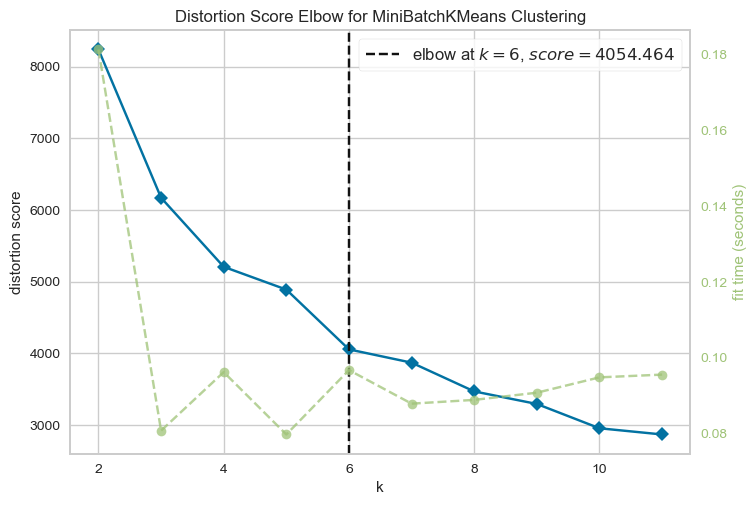

<AxesSubplot: title={'center': 'Distortion Score Elbow for MiniBatchKMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
visualizer = KElbowVisualizer(km, k=(2,12))
visualizer.fit(mat)
visualizer.show()


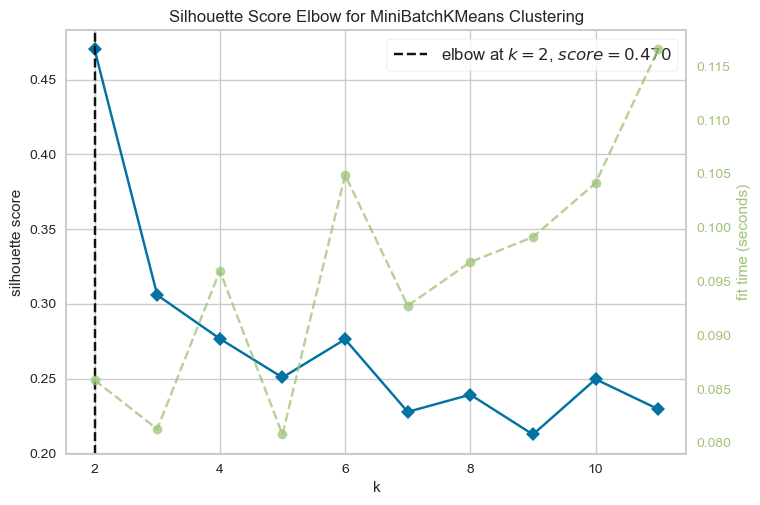

<AxesSubplot: title={'center': 'Silhouette Score Elbow for MiniBatchKMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [ ]:
visualizer = KElbowVisualizer(km, k=(2,12), metric="silhouette")
visualizer.fit(mat)
visualizer.show()

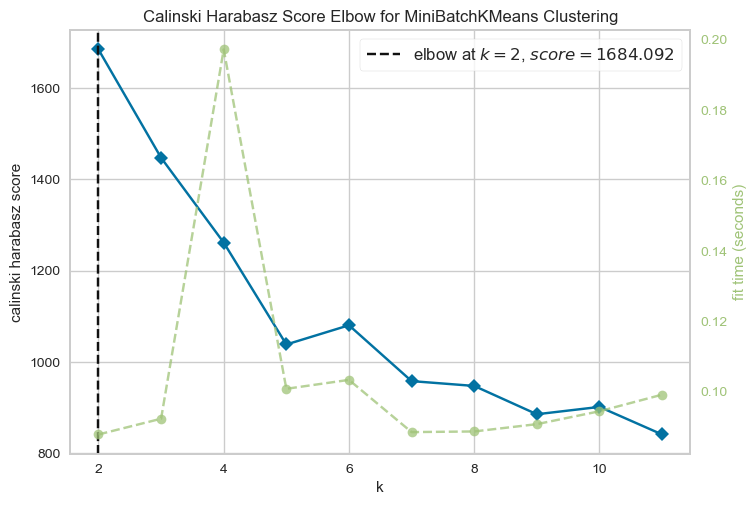

<AxesSubplot: title={'center': 'Calinski Harabasz Score Elbow for MiniBatchKMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [ ]:
visualizer = KElbowVisualizer(km, k=(2,12), metric="calinski_harabasz")
visualizer.fit(mat)
visualizer.show()

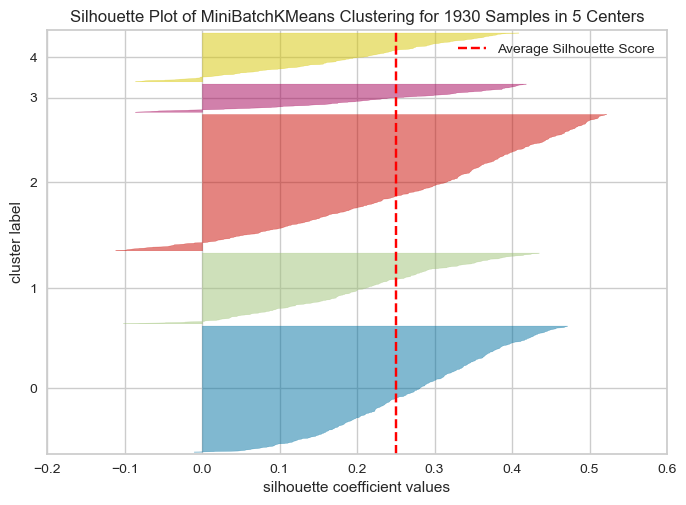

SilhouetteVisualizer(ax=<AxesSubplot: title={'center': 'Silhouette Plot of MiniBatchKMeans Clustering for 1930 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>,
                     colors='yellowbrick',
                     estimator=MiniBatchKMeans(n_clusters=5, random_state=1))

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer, silhouette_visualizer
# Instantiate the clustering model and visualizer
km = pipe['clustering'](n_clusters = 5, random_state =1)
silhouette_visualizer(km, mat, colors='yellowbrick')       # Finalize and render the figure

#### Final KMeans computation

In [ ]:
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

mat = X.values

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', MiniBatchKMeans)])
scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)
nb_cluster = 5
km = pipe['clustering'](n_clusters = nb_cluster, random_state =1)
km.fit(mat)
labels = km.labels_
inmur["label"] = labels




#### KMeans interpreter

In [ ]:
from kmeans_interp.kmeans_feature_imp import KMeansInterp
pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', KMeansInterp)])
scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)
nb_cluster = 5
km = pipe['clustering'](n_clusters = nb_cluster, random_state =1,
	ordered_feature_names=X.columns.tolist(), 
	feature_importance_method='wcss_min')
#km = KMeans(n_clusters=5)
km.fit(mat)
labels = km.labels_
inmur["label"] = labels

km.feature_importances_[0][:10]


[('Log_access', 1.7706200134017511),
 ('food_shops_access', 1.1361230946704874),
 ('education_access', 1.037210750442247),
 ('supply_shops_access', 0.9471945339754286),
 ('restaurant_access', 0.7361525040908501),
 ('culture and art_access', 0.6304369419783278),
 ('fashion_beauty_access', 0.6230921736659771),
 ('Log_soc_access', 0.47535417821118375)]

### MeanShift
Give us the main dichotomy : centre vs the rest

In [ ]:
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

mat = X.values

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', MeanShift)])

scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)

bandwidth = estimate_bandwidth(mat, quantile=0.2, n_samples=500)
ms = pipe['clustering'](bandwidth=bandwidth, bin_seeding=True)
#km = KMeans(n_clusters=5)
ms.fit(mat)
labels = ms.labels_
inmur["label"] = labels



### Agglomerative clustering

In [ ]:
from pysal.lib import weights

w_queen = weights.contiguity.Queen.from_dataframe(inmur)
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
import numpy as np
mat = X.values

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', AgglomerativeClustering)])

scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)
nb_cluster =8
clustering = pipe['clustering'](connectivity = w_queen.symmetrize().full()[0], compute_full_tree= True, distance_threshold=0, n_clusters=None)
#clustering = pipe['clustering'](n_clusters = nb_cluster,connectivity = w_queen.symmetrize().full()[0])
clustering.fit(mat)
inmur["label"] = clustering.labels_


In [ ]:
from scipy.cluster.hierarchy import dendrogram
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

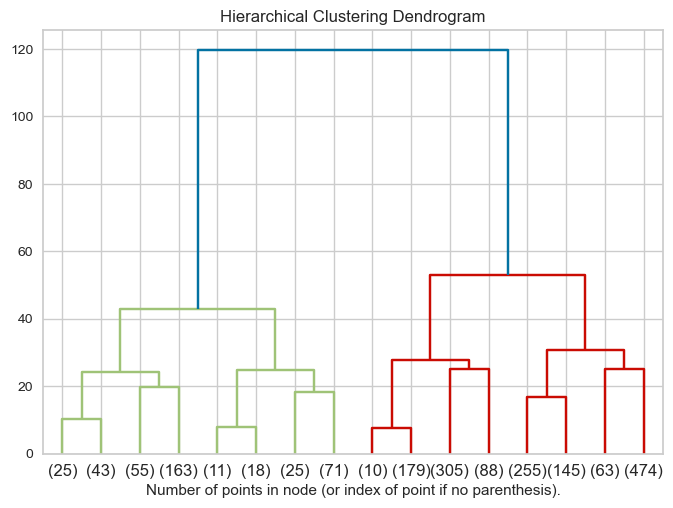

In [ ]:
import matplotlib.pyplot as plt
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(clustering, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
ax = plt.gca()
ax.set_yscale('linear')
plt.show()

### Iterations on the number of clusters/ Russian dolls maps

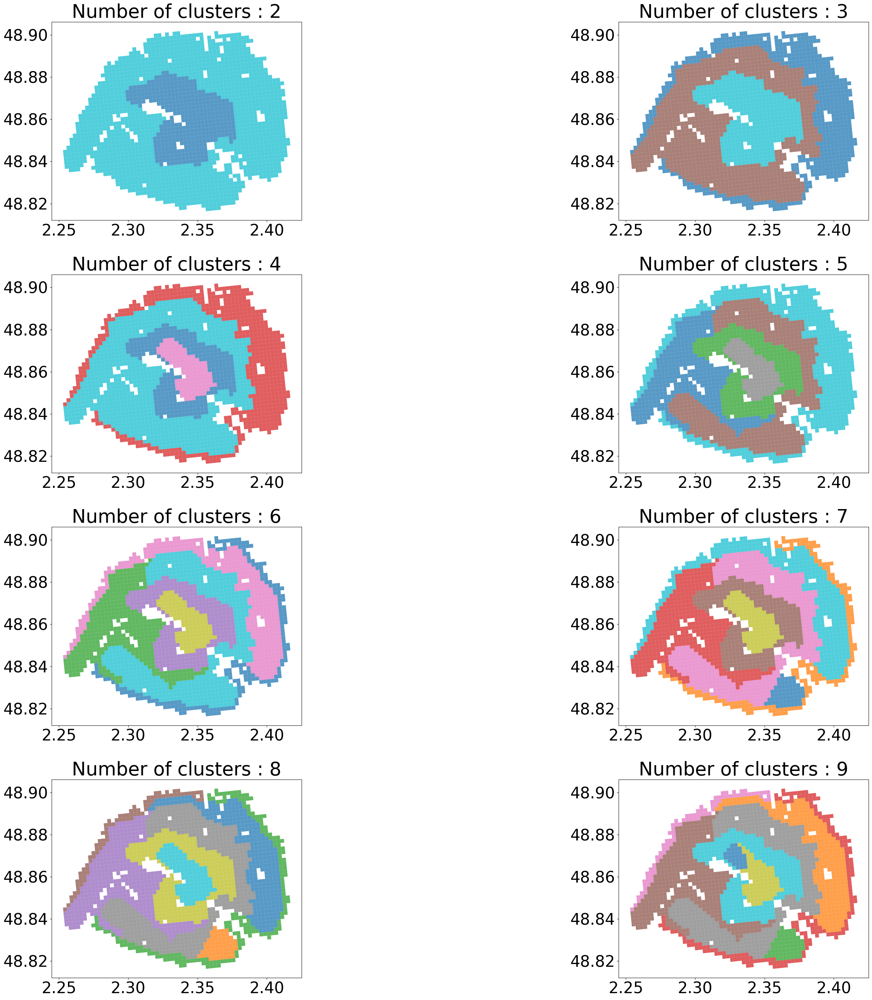

<module 'matplotlib' from 'c:\\Users\\leopo\\anaconda3\\envs\\batomouche\\lib\\site-packages\\matplotlib\\__init__.py'>

In [ ]:
n_descante = 8
from pysal.lib import weights

w_queen = weights.contiguity.Queen.from_dataframe(inmur)
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering, KMeans, MiniBatchKMeans
import numpy as np
import matplotlib as mpl
reload(mpl)
import matplotlib.pyplot as plt
font = {'size'   : 33}

mpl.rc('font', **font)
mat = X.values

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', AgglomerativeClustering)])

scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)

fig,axs = plt.subplots(ncols = 2, nrows = n_descante//2, figsize=(40,30))

for i in range(n_descante):
    n_cluster = i+2
    #clustering = pipe['clustering'](connectivity = w_queen.symmetrize().full()[0], compute_full_tree= True, distance_threshold=0, n_clusters=None)
    clustering = pipe['clustering'](n_clusters = n_cluster
            ,connectivity = w_queen.symmetrize().full()[0], #to use with aggloclustering
    )
    clustering.fit(mat)
    inmur["label"] = clustering.labels_
    ax = axs[(i-(i%2))//2][i%2]
    inmur.plot('label',ax=ax, cmap='tab10', categorical = True
    , categories = range(n_cluster-1,-1,-1)
    , alpha = 0.75
    )
    ax.set_title(f"Number of clusters : {n_cluster}")
fig.tight_layout()
plt.show()
reload(mpl)

### Visualisation

In [ ]:
hs.folium_grid_cat_plot(inmur,'label',cmap="Set1", discrete = True)

### Analysis of the clusters

#### Socio economic var

In [ ]:
inmur['Ind_mineur'] =100* (inmur['Ind_0_3']+inmur['Ind_4_5']+inmur['Ind_6_10']+inmur['Ind_11_17'])/inmur['Ind']
inmur['Ind_jeune']= 100*inmur['Ind_18_24']/inmur['Ind']
inmur['Ind_actif'] = 100*(inmur['Ind_25_39']+inmur['Ind_40_54']+inmur['Ind_55_64'])/inmur['Ind']
inmur['Ind_old'] = 100*(inmur['Ind_65_79']+inmur['Ind_80p']+inmur['Ind_55_64'])/inmur['Ind']
inmur['Men_pauv_rela'] =100* inmur['Men_pauv']/inmur['Men']
inmur['Men_1ind_rela'] =100* inmur['Men_1ind']/inmur['Men']
inmur['Men_5ind_rela'] = 100*inmur['Men_5ind']/inmur['Men']
inmur['Men_prop_rela'] = 100*inmur['Men_prop']/inmur['Men']
inmur['Men_fmp_rela'] = 100*inmur['Men_fmp']/inmur['Men']
inmur['mean_Ind_snv'] = inmur['Ind_snv']/inmur['Ind'] 


In [ ]:
varSocioEco = ['Men_pauv_rela', 'Men_1ind_rela',
       'Men_5ind_rela', 'Men_prop_rela', 'Men_fmp_rela','Ind', 'mean_Ind_snv','Ind_mineur', 
       'Ind_jeune', 'Ind_actif', 'Ind_old']

#### dico var

In [ ]:
dico_var = {'Ind' : "Nombre d’individus",
'Men' : "Nombre de ménages",
'Men_pauv' : "Nombre de ménages pauvres",
'Men_1ind' : "Nombre de ménages d’un seul individu",
'Men_5ind' : "Nombre de ménages de 5 individus ou plus",
'Men_prop' : "Nombre de ménages propriétaires",
'Men_fmp' : "Nombre de ménages monoparentaux",
'Men_pauv_rela' : "% de ménages pauvres",
'Men_1ind_rela' : "% de ménages d’un seul individu",
'Men_5ind_rela' : "% de ménages de 5 individus ou plus",
'Men_prop_rela' : "% de ménages propriétaires",
'Men_fmp_rela' : "% de ménages monoparentaux",
'Ind_snv' : "Somme des niveaux de vie winsorisés des individus",
'mean_Ind_snv' : "Moyenne des niveaux de vie winsorisés des individus",
'Ind_0_3' : "Nombre d’individus de 0 à 3 ans",
'Ind_4_5' : "Nombre d’individus de 4 à 5 ans",
'Ind_6_10' : "Nombre d’individus de 6 à 10 ans",
'Ind_11_17' : "Nombre d’individus de 11 à 17 ans",
'Ind_18_24' : "Nombre d’individus de 18 à 24 ans",
'Ind_25_39' : "Nombre d’individus de 25 à 39 ans",
'Ind_40_54' : "Nombre d’individus de 40 à 54 ans",
'Ind_55_64' : "Nombre d’individus de 55 à 64 ans",
'Ind_65_79' : "Nombre d’individus de 65 à 79 ans",
'Ind_80p' : "Nombre d’individus de 80 ans ou plus", 
'Ind_mineur' : "% d’individus de 0 à 17 ans",
'Ind_jeune': "% d’individus de 18 à 24 ans",
'Ind_actif' : "% d’individus de 25 à 64 ans",
'Ind_old' :"% d’individus de 65 ans ou plus",
'Log_access': '2SFCA Logements',
'Log_soc_access': '2SFCA Logements sociaux',
'restaurant_access': '2SFCA restaurants',
'culture and art_access': '2SFCA culture and art',
'education_access': '2SFCA education',
'food_shops_access': '2SFCA food shops',
'fashion_beauty_access': '2SFCA fashion beauty',
'supply_shops_access': '2SFCA supply shops'
}

#### Violin plots on accessibility scores

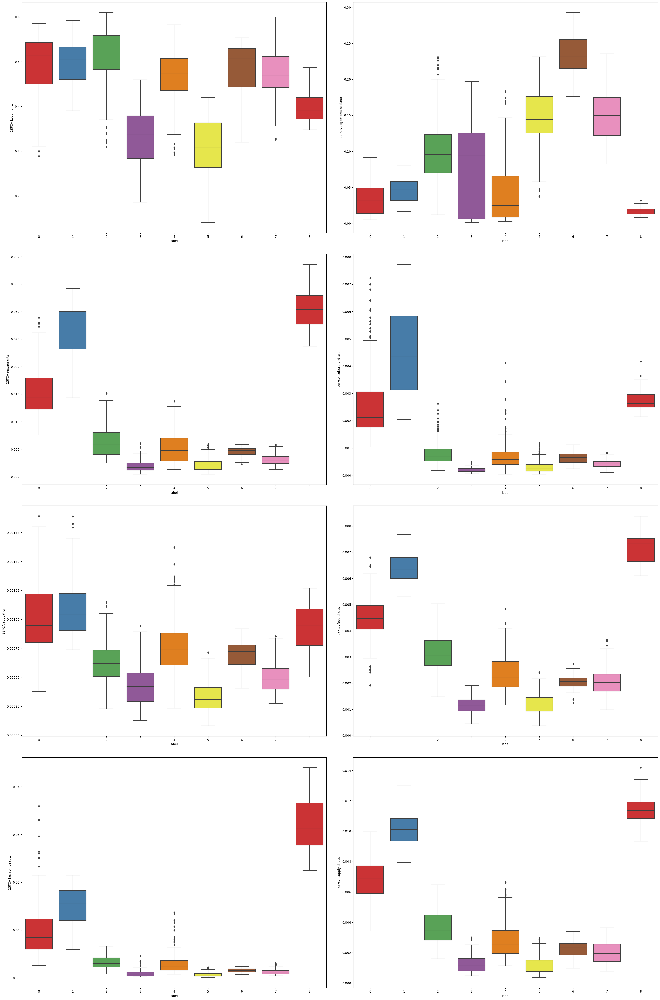

In [ ]:
base_bis = inmur[['label']+varSocioEco+clusterVar]
hs.boxplots(base_bis,clusterVar,nb_cluster,dico_var=dico_var,ttest=False)

#### Clusters data on the socio eco var.
we can also do a box plot cf visualize.py

In [ ]:
varSocioEcoShort = ['Men_pauv_rela','mean_Ind_snv', 'Ind_mineur',
 'Ind_jeune',
 'Ind_actif',
 'Ind_old']

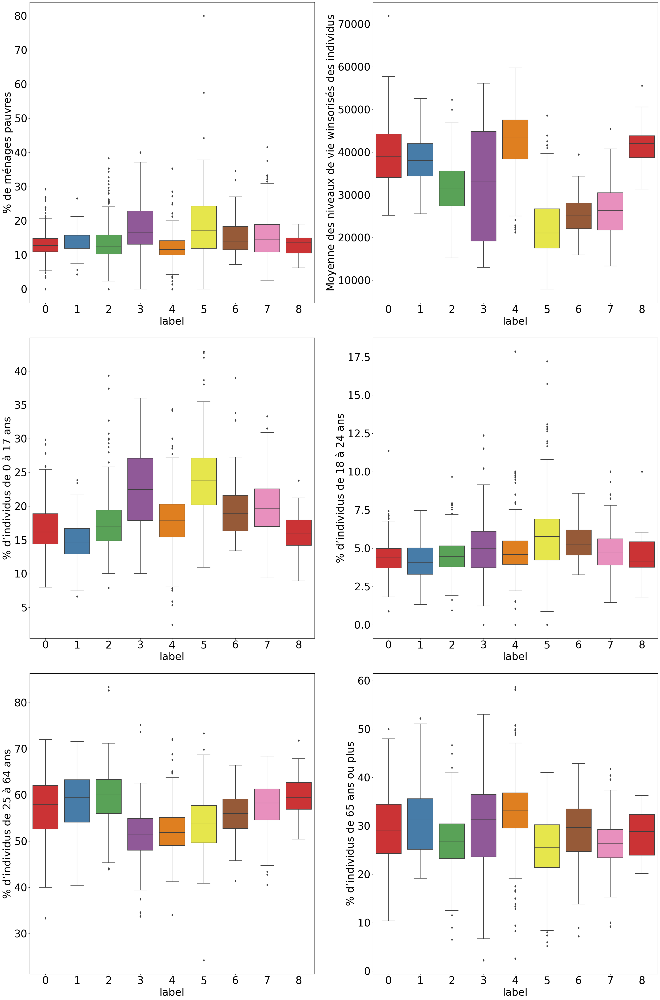

In [ ]:
hs.boxplots(base_bis,varSocioEcoShort,nb_cluster,dico_var=dico_var,ttest=False)

# Analyse en grandes dimensions

## Creation of the database

In [ ]:
filosofi_file = "data/Filosofi2015_carreaux_200m_paris.gpkg"
pgdf = hs.get_POI_cat_on_INSPIRE_grid(filosofi_file,city = "Paris", reduced_cat= False)

c:\Users\leopo\OneDrive - GENES\BATO-MOUCHE-Stat-App\helpers\scrapping.py:192: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\geopandas\geodataframe.py:1443: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\geopandas\geodataframe.py:1443: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.cop

In [ ]:
# weights can be a bit long so it's preferable to create a variable
idCol = "IdINSPIRE"
weights_by_id = hs.calculate_distanceband_weights(pgdf,idCol=idCol) 
# note it sets the idCol as index for the rest of the program to work weights_by_id and gdf needs to have the same index

c:\Users\leopo\OneDrive - GENES\BATO-MOUCHE-Stat-App\helpers\scrapping.py:570: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [ ]:
bois = ["CRS3035RES200mN2891600E3754800","CRS3035RES200mN2891600E3754400","CRS3035RES200mN2891800E3754000","CRS3035RES200mN2892000E3753800",
        "CRS3035RES200mN2891800E3753200","CRS3035RES200mN2891400E3753200","CRS3035RES200mN2891600E3752000","CRS3035RES200mN2891400E3752400",
        "CRS3035RES200mN2891200E3751800","CRS3035RES200mN2891000E3752200","CRS3035RES200mN2890600E3752000","CRS3035RES200mN2890000E3751400",
        "CRS3035RES200mN2890200E3752600","CRS3035RES200mN2889400E3752600","CRS3035RES200mN2890600E3753600","CRS3035RES200mN2890000E3753200",
        "CRS3035RES200mN2889800E3753600","CRS3035RES200mN2890400E3754000","CRS3035RES200mN2890200E3754000","CRS3035RES200mN2893000E3764400",
        "CRS3035RES200mN2887000E3754400","CRS3035RES200mN2887000E3754600","CRS3035RES200mN2887200E3754800","CRS3035RES200mN2887400E3754800",
        "CRS3035RES200mN2885600E3762800","CRS3035RES200mN2885600E3764600","CRS3035RES200mN2886200E3765200","CRS3035RES200mN2886400E3765400",
        "CRS3035RES200mN2885600E3765400","CRS3035RES200mN2886000E3765800","CRS3035RES200mN2886400E3766200","CRS3035RES200mN2886600E3766400",
        "CRS3035RES200mN2886400E3766800","CRS3035RES200mN2886600E3766800","CRS3035RES200mN2886600E3767000","CRS3035RES200mN2886600E3767200",
        "CRS3035RES200mN2886400E3767600","CRS3035RES200mN2886400E3768000","CRS3035RES200mN2886600E3768200","CRS3035RES200mN2886000E3767000",
        "CRS3035RES200mN2886000E3767600","CRS3035RES200mN2885600E3768000","CRS3035RES200mN2885000E3767000","CRS3035RES200mN2885000E3767400",
        "CRS3035RES200mN2885000E3768200","CRS3035RES200mN2884600E3768200","CRS3035RES200mN2884400E3768000"]

In [ ]:
interestVar = hs.amenities + hs.shops

In [ ]:
accessibility_measures = hs.calculate_2SFCA_accessibility(pgdf,interestVar,weights_by_id)

In [ ]:
accessibility_measures.rename(columns={var:var+"_access" for var in interestVar} ,inplace= True)

In [ ]:
pgdf = pgdf.join(accessibility_measures)

## PCA

In [ ]:
reload(mpl)

<module 'matplotlib' from 'c:\\Users\\leopo\\anaconda3\\envs\\batomouche\\lib\\site-packages\\matplotlib\\__init__.py'>

In [ ]:
pcaVar = [var+"_access" for var in interestVar]

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

inmur = pgdf.drop(bois)

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('reduc_dim', PCA)])

In [ ]:
import pandas as pd
X = inmur[pcaVar]

scaler = pipe['preprocessor']().set_output(transform="pandas")
scaler.fit(X=X)
X = scaler.transform(X)
n_components = 5
pca = pipe['reduc_dim'](n_components = n_components).set_output(transform="pandas")
pca.fit(X)

PCA(n_components=5)

In [ ]:
pca.singular_values_

array([309.48761822, 159.91270344, 134.96313957, 114.20437113,
       105.68011028])

In [ ]:
pcaComponents = {pca.feature_names_in_[i]:pca.components_[:,i] for i in range(pca.n_features_in_)}

In [ ]:
pca.explained_variance_ratio_

array([0.28359019, 0.07571302, 0.05393057, 0.03861625, 0.03306672])

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\seaborn\categorical.py:332: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\seaborn\utils.py:551: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



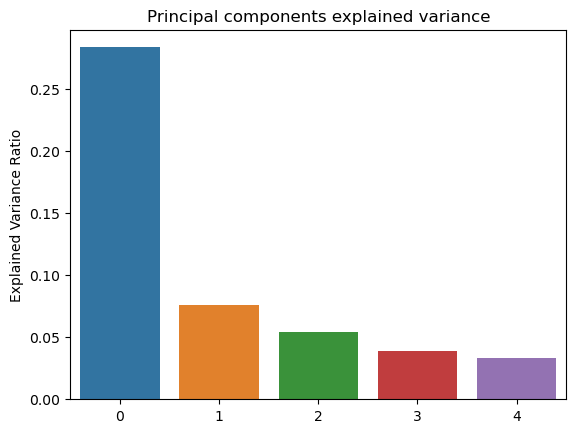

In [ ]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

ax = sns.barplot(y = pca.explained_variance_ratio_, x = np.arange(n_components))
plt.ylabel("Explained Variance Ratio")
plt.title("Principal components explained variance")
plt.show()

In [ ]:
import pandas as pd
pcCoefs = pd.DataFrame(index=pca.feature_names_in_)
for pc in range(pca.n_components_):
    pcCoefs[f"pc{pc}"]= [pca.components_[pc,i] for i in range(pca.n_features_in_)]

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\seaborn\categorical.py:332: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\seaborn\utils.py:551: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



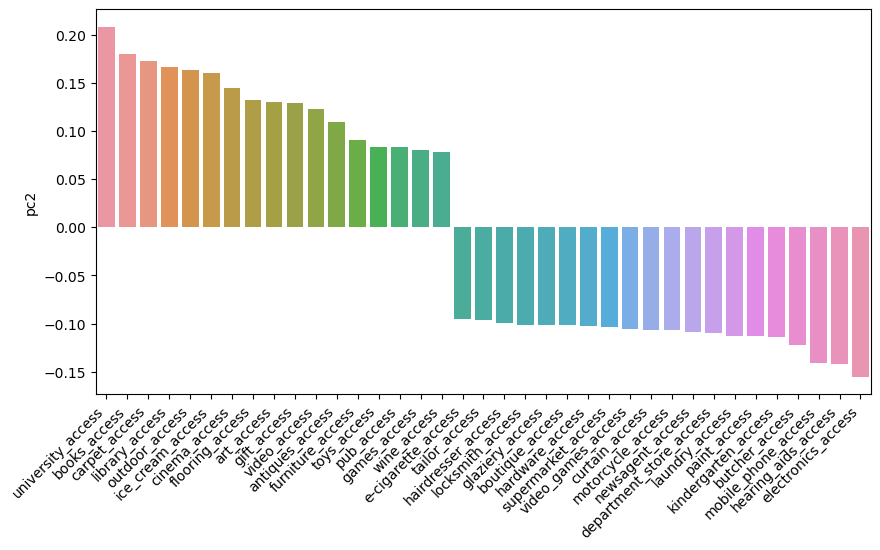

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
pc=2
plt.figure(figsize=(10,5))
pcCoefs.sort_values(f"pc{pc}",inplace=True, ascending=False)
topbot = pd.concat([pcCoefs.head(20)
                    ,pcCoefs.tail(20)
                    ])
ax = sns.barplot(data=topbot, y=f"pc{pc}", x=topbot.index)
#ax = sns.barplot(data=pcCoefs,y=f"pc{pc}", x=pcCoefs.index)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

In [ ]:
reload(mpl)

<module 'matplotlib' from 'c:\\Users\\leopo\\anaconda3\\envs\\batomouche\\lib\\site-packages\\matplotlib\\__init__.py'>

In [ ]:
print(100*len(pcCoefs[pcCoefs["pc0"]>0])/len(pcCoefs),100*len(pcCoefs[pcCoefs["pc0"]<0])/len(pcCoefs))

80.82901554404145 10.362694300518134


In [ ]:
inmur_pca = inmur.join(pca.transform(X))

In [ ]:
inmur_pca.head()

,index,Id_carr1km,I_est_cr,Id_carr_n,Groupe,Depcom,I_pauv,Id_car2010,Ind,Men,...,tobacco_access,toys_access,travel_agency_access,weapons_access,vacant_access,pca0,pca1,pca2,pca3,pca4
IdINSPIRE,,,,,,,,,,,,,,,,,,,,,
CRS3035RES200mN2893400E3763200,0,CRS3035RES1000mN2893000E3763000,0,CRS3035RES1000mN2893000E3763000,866132,75119,0,CRS3035RES200mN2893400E3763200,2818.5,990.0,...,0.000023,0.000000,0.000000,0.000000,0.000165,-6.729567,0.853369,0.946559,-2.289457,0.338777
CRS3035RES200mN2890000E3762200,1,CRS3035RES1000mN2890000E3762000,0,CRS3035RES200mN2890000E3762200,862504,75111,0,CRS3035RES200mN2890000E3762200,1543.5,926.0,...,0.000102,0.000052,0.000130,0.000025,0.000980,8.805862,-10.088852,-5.580086,2.563887,5.674097
CRS3035RES200mN2893400E3762400,2,CRS3035RES1000mN2893000E3762000,0,CRS3035RES1000mN2893000E3762000,866107,75119,0,CRS3035RES200mN2893400E3762400,1338.0,508.0,...,0.000048,0.000000,0.000005,0.000000,0.000071,-6.377494,0.787630,1.264875,-1.914811,0.402656
CRS3035RES200mN2891800E3763600,3,CRS3035RES1000mN2891000E3763000,0,CRS3035RES200mN2891800E3763600,862421,75119,0,CRS3035RES200mN2891800E3763600,1235.5,633.0,...,0.000028,0.000033,0.000043,0.000000,0.000115,-5.134345,-0.415168,0.334222,-0.956881,-0.354709
CRS3035RES200mN2890800E3763200,4,CRS3035RES1000mN2890000E3763000,0,CRS3035RES200mN2890800E3763200,862464,75120,0,CRS3035RES200mN2890800E3763200,685.0,349.0,...,0.000081,0.000021,0.000110,0.000000,0.000390,-2.115646,-3.253490,-2.383906,-1.685546,-1.792548


In [ ]:
pc = 1
hs.folium_grid_cat_plot(inmur_pca[[f'pca{pc}','geometry']],f'pca{pc}','Set1')

## Clustering

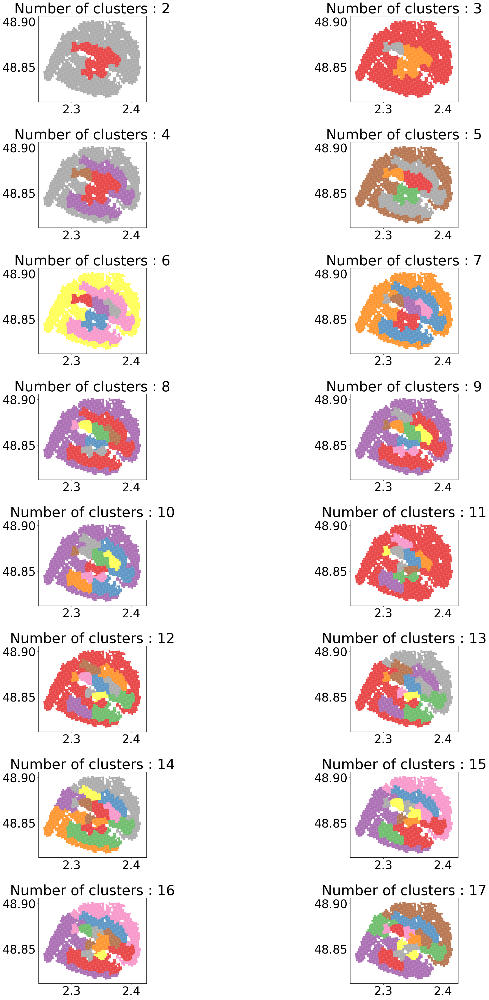

<module 'matplotlib' from 'c:\\Users\\leopo\\anaconda3\\envs\\batomouche\\lib\\site-packages\\matplotlib\\__init__.py'>

In [ ]:
n_descante = 16 #needs to be even
from pysal.lib import weights

w_queen = weights.contiguity.Queen.from_dataframe(inmur)

from sklearn.cluster import AgglomerativeClustering
import numpy as np
import matplotlib as mpl
reload(mpl)
font = {'size'   : 33}

mpl.rc('font', **font)
mat = X.values

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', AgglomerativeClustering)])

scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)

fig,axs = plt.subplots(ncols = 2, nrows = n_descante//2, figsize=(30,40))

for i in range(n_descante):
    n_cluster = i+2
    #clustering = pipe['clustering'](connectivity = w_queen.symmetrize().full()[0], compute_full_tree= True, distance_threshold=0, n_clusters=None)
    clustering = pipe['clustering'](n_clusters = n_cluster,
    connectivity = w_queen.symmetrize().full()[0], #to use with aggloclustering
    )
    clustering.fit(mat)
    inmur["label"] = clustering.labels_
    ax = axs[(i-(i%2))//2][i%2]
    inmur.plot('label',ax=ax, cmap='Set1', categorical = True
    , categories = range(n_cluster)
    , alpha = 0.8
    )
    ax.set_title(f"Number of clusters : {n_cluster}")
fig.tight_layout()
plt.show()
reload(mpl)

In [ ]:
from pysal.lib import weights

w_queen = weights.contiguity.Queen.from_dataframe(inmur)

from sklearn.cluster import AgglomerativeClustering
import numpy as np
mat = X.values

pipe = Pipeline(steps=[('preprocessor', StandardScaler),
                      ('clustering', AgglomerativeClustering)])

scaler = pipe['preprocessor']()
scaler.fit(X=mat)
mat = scaler.transform(mat)
nb_cluster =3
#clustering = pipe['clustering'](connectivity = w_queen.symmetrize().full()[0], compute_full_tree= True, distance_threshold=0, n_clusters=None)
clustering = pipe['clustering'](n_clusters = nb_cluster,connectivity = w_queen.symmetrize().full()[0])
clustering.fit(mat)
inmur_pca["label"] = clustering.labels_


c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\seaborn\relational.py:559: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\seaborn\relational.py:913: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

c:\Users\leopo\anaconda3\envs\batomouche\lib\site-packages\seaborn\relational.py:950: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



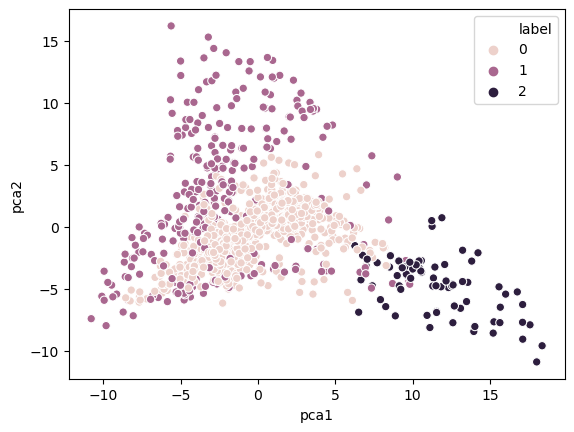

In [ ]:
ax = sns.scatterplot(data=inmur_pca, x="pca1",y="pca2",cmap='Set1',hue="label")
plt.show()